<a href="https://colab.research.google.com/github/evertonsilvauea/uea_cid_cocobambu/blob/main/trabalho_analise_de_sentimentos_cid20.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


#Universidade do Estado do Amazonas
Escola Superior de Tecnologia
>Pós-graduação Lato Sensu em Ciência de Dados
>>Programação para Ciência de Dados (Turma 02)

#Equipe

*   Charles Santa Rosa
*   Everton da Silva e Silva
*   Luiz Junior

#Sumário
Pré-inicialização

>1. Instalando GoogleTrans, TextBlob e outros pacotes

>2. Instalando folium

>3. Importando Bibliotecas

>4. Clonando o repositório do GIT

>5. Lendo e processando a fonte de dados

>6. Explorando os dados

>7. Analisando comentários por estados do Brasil

>8. Análise temporal dos comentários

>9. Processando e normalizando os dados obtidos

>10. Selecionando 200 sentenças aleatoriamente

>11. Identificando as sentenças objetivas e subjetivas

>12. Classificando as sentenças em positivas(1), negativas(-1) ou neutras(0)

>13. Gerando arquivo csv com 3 colunas (sentença, identificação e classificação)

>14. Análise e discurssão proposta: Questão 1

>15. Visão geográfica dos comentários

#Pré-inicialização

#Instalando GoogleTrans, TextBlob e outros pacotes

In [1]:
!pip install googletrans

     |████████████████████████████████| 61kB 3.3MB/s 
     |████████████████████████████████| 983kB 8.0MB/s 
     |████████████████████████████████| 51kB 6.3MB/s 
     |████████████████████████████████| 71kB 6.3MB/s 
     |████████████████████████████████| 61kB 8.0MB/s 
     |████████████████████████████████| 102kB 8.9MB/s 
  Created wheel for googletrans: filename=googletrans-3.0.0-cp36-none-any.whl size=15736 sha256=f1fd8cc725625ff0cdab6984a662a10f68dbe74f260abd00f8c0877f6ad7bee0
  Stored in directory: /root/.cache/pip/wheels/28/1a/a7/eaf4d7a3417a0c65796c547cff4deb6d79c7d14c2abd29273e
  Created wheel for contextvars: filename=contextvars-2.4-cp36-none-any.whl size=7666 sha256=ef6bda77e046363ddb7d9c4f3657174bab76b41b4a950b4be6adcb544a2b15e0
  Stored in directory: /root/.cache/pip/wheels/a5/7d/68/1ebae2668bda2228686e3c1cf16f2c2384cea6e9334ad5f6de
Successfully built googletrans contextvars


In [2]:
!python -m textblob.download_corpora
!pip install fsspec

[nltk_data] Downloading package brown to /root/nltk_data...
[nltk_data]   Unzipping corpora/brown.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package conll2000 to /root/nltk_data...
[nltk_data]   Unzipping corpora/conll2000.zip.
[nltk_data] Downloading package movie_reviews to /root/nltk_data...
[nltk_data]   Unzipping corpora/movie_reviews.zip.
Finished.
     |████████████████████████████████| 92kB 3.6MB/s 


#Instalando folium

In [3]:
!pip install folium
!pip install geopandas

     |████████████████████████████████| 972kB 4.2MB/s 
     |████████████████████████████████| 6.5MB 14.9MB/s 
     |████████████████████████████████| 14.8MB 327kB/s 


#Importando Bibliotecas

# Clonando o reposítório

In [4]:
import numpy as np
import pandas as pd
from random import sample
import json
from textblob import TextBlob
import googletrans as Translator
import random
import threading
import matplotlib.pyplot as plt
import seaborn as sns
import time
import folium
import geopandas
import csv
import re
from bs4 import BeautifulSoup as bs


In [5]:
def init_git():
    !git clone https://github.com/charlessantarosa/analise-de-sentimentos.git
    !ls -la

init_git()

Cloning into 'analise-de-sentimentos'...
remote: Enumerating objects: 22, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 22 (delta 8), reused 5 (delta 0), pack-reused 0
Unpacking objects: 100% (22/22), done.
total 20
drwxr-xr-x 1 root root 4096 Nov 28 12:27 .
drwxr-xr-x 1 root root 4096 Nov 28 12:22 ..
drwxr-xr-x 3 root root 4096 Nov 28 12:27 analise-de-sentimentos
drwxr-xr-x 1 root root 4096 Nov 20 17:15 .config
drwxr-xr-x 1 root root 4096 Nov 13 17:33 sample_data


# Lendo e processando a fonte de dados

In [6]:
def open_dataset():
    file = open('analise-de-sentimentos/dataset-v2.dat', 'r')
    dados = pd.read_table('analise-de-sentimentos/dataset-v2.dat')
    results = list()
    for line in file:
        col = line.split('\n')
        results.append(col[0])
    #print(len(dados))
    return results, dados

results = open_dataset()
print(len(results[0]))

100000


# Explorando os dados

In [7]:
json.loads(results[0][1])


{'author': 'Pano P',
 'itemReviewed': {'address': {'addressLocality': '',
   'addressRegion': 'Rio Grande do Norte',
   'country': 'Brasil',
   'postalCode': '59092-100',
   'streetAddress': 'Avenida Praia de Ponta Negra 9068 Ponta Negra'},
  'averageRating': '4.5',
  'email': 'guacamolenatal@gmail.com',
  'name': 'Guacamole Natal',
  'phoneNumber': '+55 84 3219-3646',
  'website': 'http://www.facebook.com/GuacamoleNatal'},
 'language': 'pt',
 'mobileDevice': 'True',
 'publicationDate': '16/09/2014',
 'ratingValue': '4',
 'restaurantId': '3720906',
 'reviewBody': 'Comida boa, drinks legais e um ambiente bem aconchegante. \nProvamos muitas coisas e tudo nos agradou. Principalmente um pato servido em um dos pratos da casa, sensacional!',
 'reviewId': '229208487',
 'title': 'Uma boa experiência.',
 'userLocation': 'Manaus, AM',
 'visitDate': 'None'}

# Analisando comentários por estados do Brasil

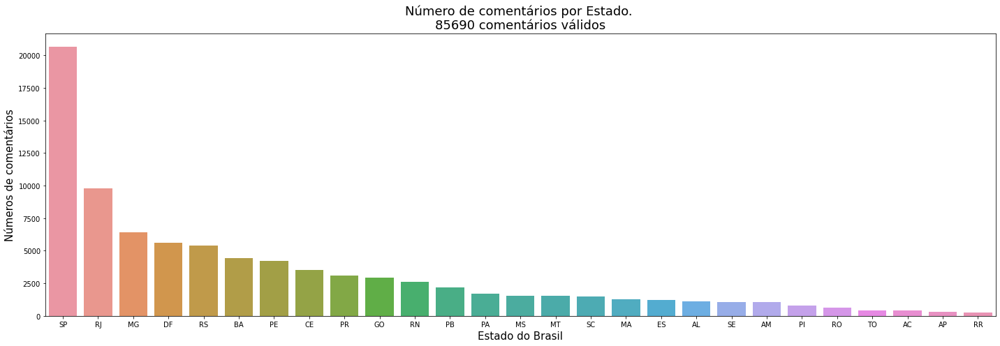

In [8]:
dados = pd.read_table('analise-de-sentimentos/dataset-v2.dat')
estados = ["AC","AL","AP","AM","BA","CE","DF","ES","GO","MA","MS","MT","MG","PA","PB","PR","PE","PI","RJ","RN","RS","RO","RR","SC","SP","SE","TO"]
numComm = [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]
#numCommMobile = 0

# Vars to dataset
comments = []
mobileDevice = []
publicationDate = []
reviewId = []

for value in dados.values:
  d = json.loads(value.item())
  # comment = TextBlob(d['reviewBody'])
  # commentUs = comment.translate(to='us')
  # print(commentUs)
  userLocation = d['userLocation'].split(', ')

  try:    

    comments.append(d['reviewBody'])
    mobileDevice.append(d['mobileDevice'])
    publicationDate.append(d['publicationDate'])
    reviewId.append(d['reviewId'])

    if userLocation[1] in estados:
      index = estados.index(userLocation[1]);     
      numComm[index] += 1            

  except:
    continue

fig = plt.figure(figsize = (20, 7))
df = pd.DataFrame({"Estados": estados, "Comentarios": numComm})
sns.barplot(x='Estados', y="Comentarios", data=df, order=df.sort_values('Comentarios',ascending = False).Estados)
totalComm = np.sum(numComm,axis=0)

# Numero de comentarios no Brasil
plt.xlabel("Estado do Brasil", size=15)
plt.ylabel("Números de comentários", size=15)
plt.title(f'Número de comentários por Estado. \n{totalComm} comentários válidos', size=18)
plt.tight_layout()
plt.savefig("barplot_Seaborn_Python.png", dpi=100)
plt.show()


In [9]:
import pandas as pd
import folium
import pandas as pd
import json

train_dataset = pd.read_csv('analise-de-sentimentos/taxa_br.csv')
print(train_dataset.head())
br_estados = 'analise-de-sentimentos/br_states.json'
geo_json_data = json.load(open(br_estados))
taxa_coments = pd.read_csv('analise-de-sentimentos/taxa_br.csv', sep=';', decimal=',', usecols=['Sigla', 'Num_Coments'])
taxa_coments.head(3)
taxa_coments.rename(columns={
     'Sigla': 'estado', 
     'Num_Coments': '2020'}, inplace=True)
taxa_coments.head(3)
taxa_coments.describe()

from branca.colormap import linear
colormap = linear.YlOrRd_09.scale(6,20)
colormap

taxa_comentario_estado = taxa_coments.set_index('estado')['2020']
mapa = folium.Map(
    width=600, height=400,
    location=[-15.77972, -47.92972], 
    zoom_start=4
)
folium.GeoJson(
    geo_json_data,
    name='2020',
    style_function=lambda feature: {
        'fillColor': colormap(taxa_comentario_estado[feature['id']]),
        'color': 'black',
        'weight': 0.3,
    }
    
).add_to(mapa)
colormap.caption = 'Numero de Comentarios por Estado 2020'
colormap.add_to(mapa)
folium.LayerControl(collapsed=False).add_to(mapa)
mapa.save('taxa_br_2020.html')
mapa

                Sigla;Unidade da Federação;Num_Coments
RO;Rondônia;"8                                      9"
AC;Acre;"13                                         1"
AM;Amazonas;"14                                     4"
RR;Roraima;14                                      NaN
PA;Pará;"10                                         2"


# Análise temporal dos comentários

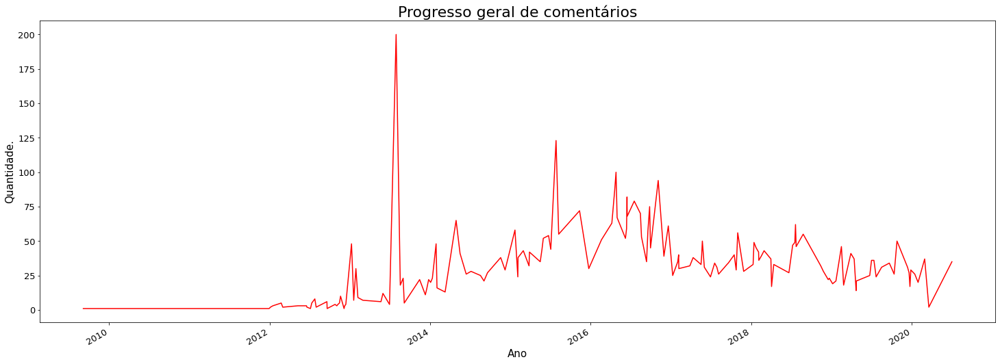

In [ ]:
# Progresso anual dos comentarios
data = pd.Series(pd.to_datetime(publicationDate))
ax = data.value_counts()[::20].plot(kind='line', figsize=(25,9), color="red", fontsize=13)
ax.set_alpha(0.8)
ax.set_title("Progresso geral de comentários", fontsize=22)
ax.set_ylabel("Quantidade.", fontsize=15);
ax.set_xlabel("Ano", fontsize=15);
plt.show()

# Processando e normalizando os dados obtidos

In [10]:
def open_data_():

    dados = open('analise-de-sentimentos/dataset-v2.dat')
    a = dados.readlines()
    v = []
    for c in a:
        parsed_c = json.loads(c)
        data = pd.json_normalize(parsed_c)
        v.append(data)
    df = pd.concat(objs=v,axis=0)
    return df

df = open_data_()



>Renomeando as colunas para melhorar o acesso às informações

In [11]:
def rename_columns(df):
    df = df.rename(columns={'itemReviewed.name':'restaurantName','itemReviewed.address.streetAddress':'stressAddress','itemReviewed.address.addressLocality':'addressLocality','itemReviewed.address.addressRegion':'addressRegion','itemReviewed.address.postalCode':'postalCode','itemReviewed.address.country':'country','itemReviewed.website':'website','itemReviewed.email':'email','itemReviewed.phoneNumber':'phoneNumber','itemReviewed.averageRating':'averageRating'})
    df = df.reset_index(drop=True)
    df.head(10)
    return df

renamed_df = rename_columns(df)
renamed_df


,title,reviewId,restaurantId,author,reviewBody,language,mobileDevice,userLocation,publicationDate,visitDate,ratingValue,restaurantName,stressAddress,addressLocality,addressRegion,postalCode,country,website,email,phoneNumber,averageRating
0,Jantar,692856288,2344932,larinhavercosa222,"Comida maravilhosa, lugar do verdadeiro chicle...",pt,True,"São Carlos, SP",26/07/2019,07/2019,5,Imperador dos Camarões,Avenida Doutor Antônio Gouveia,,Alagoas,57030-170,Brasil,http://www.imperadordoscamaroes.com.br,contato@imperadordoscamaroes.com.br,+55 82 3231-4134,4.5
1,Uma boa experiência.,229208487,3720906,Pano P,"Comida boa, drinks legais e um ambiente bem ac...",pt,True,"Manaus, AM",16/09/2014,None,4,Guacamole Natal,Avenida Praia de Ponta Negra 9068 Ponta Negra,,Rio Grande do Norte,59092-100,Brasil,http://www.facebook.com/GuacamoleNatal,guacamolenatal@gmail.com,+55 84 3219-3646,4.5
2,Otimo self service,679002332,2248105,Magma100,"Excelente pra ir com a família! Ótima Comida, ...",pt,True,"Goiânia, GO",04/06/2019,07/2018,4,Chica Pitanga,Rua Petrolina 19,Recife,Pernambuco,51021-250,Brasil,http://www.chicapitanga.com.br,chicapitanga@chicapitanga.com.br,+55 81 3334-8260,4.5
3,O sorvete mais tradicional do estado,355671519,8168302,Yurie M,Tomo sorvete na Visabor faz mais de 30 anos. S...,pt,False,"Aracaju, SE",15/03/2016,01/2016,5,Sorvetes Vi Sabor,Avenida Francisco Porto 59 Grageru,Aracaju,Sergipe,,Brasil,None,None,None,4.0
4,Melhor hamburger!,268741921,5395141,Debora_C85,O melhor hamburger que já comi! Excelente aten...,pt,False,"Rio de Janeiro, RJ",28/04/2015,04/2015,5,Z Deli Sandwich Shop,Rua Haddock Lobo 1386 Jardins,São Paulo,Estado de São Paulo,01414-002,Brasil,http://www.facebook.com/zdelisandwichshop/,None,551130830021,4.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,Nova opção no Paseo!!!,672210394,17424548,Fabiano B,"Ainda não inaugurado oficialmente, está atende...",pt,True,"Porto Alegre, RS",07/05/2019,05/2019,5,Boteco Maestro,Avenida Wenceslau Escobar 1823,Porto Alegre,Rio Grande do Sul,91900-000,Brasil,http://www.facebook.com/botecomaestro,None,+55 51 99353-6602,4.0
99996,Bom,380904400,2440184,Chris L,"Bom atendimento, lugar bonito, comida muito go...",pt,True,"Cork, Irlanda",08/06/2016,01/2016,4,Casa do Marquês,"Rua Marques do Pombal, 1814 Higienópolis",Porto Alegre,Rio Grande do Sul,90540-000,Brasil,http://galeteriacasadomarques.com.br/,galeteriacasadomarques@galeteriacasadomarques....,+55 51 3343-4303,4.5
99997,Bom bar,186111858,2392996,Guilherme P,O Rio Scenarium é uma das baladas mais famosas...,pt,False,"São Paulo, SP",27/11/2013,11/2013,4,Rio Scenarium,Rua do Lavradio 20 Centro,Rio de Janeiro,Estado do Rio de Janeiro,20230-070,Brasil,http://www.rioscenarium.art.br,None,+55 21-3147-9000,4.5
99998,Me senti enganada...,152745909,1062290,LisianeCohem,"Fui por indicação e com boa expectativa!\n116,...",pt,True,"Porto Alegre, RS",21/02/2013,None,2,Celeiro,Rua Dias Ferreira 199,Rio de Janeiro,Estado do Rio de Janeiro,22431-050,Brasil,http://www.celeiroculinaria.com.br,celeiro@celeiroculinaria.com.br,55 21 2274 7843,3.5


In [12]:
def get_sentences_random_index(qtde):
    sentences_index = sample(range(0,100000),qtde)
    return sentences_index

sentences_index = get_sentences_random_index(200)
sentences_index.sort()
print(sentences_index)

[1510, 1705, 2291, 3296, 3768, 4554, 5855, 6072, 6549, 6587, 6610, 6614, 6710, 7077, 7424, 7576, 8324, 8917, 9371, 9887, 10361, 10767, 11768, 11779, 12271, 12818, 13119, 13972, 14082, 14179, 14569, 14596, 15477, 15534, 15571, 16145, 16490, 16513, 16864, 16919, 16954, 17007, 17399, 18405, 19197, 19511, 19820, 21085, 21396, 21916, 22516, 23389, 23629, 23911, 24372, 24699, 26235, 26800, 27084, 28290, 28852, 29358, 29400, 30612, 32311, 36273, 36391, 37417, 37499, 39152, 40048, 40125, 40130, 40383, 40500, 40909, 41734, 42123, 42865, 43097, 43302, 43383, 43701, 44171, 44186, 44461, 44757, 44779, 44784, 46456, 47216, 47343, 47945, 48031, 48684, 49737, 49796, 49885, 49964, 50605, 50929, 51755, 51978, 52065, 53139, 53985, 54733, 55371, 55768, 56044, 57975, 58079, 58500, 58529, 60325, 61301, 61613, 61644, 62050, 63020, 64391, 64392, 65698, 65976, 66313, 66583, 67401, 67570, 67745, 67794, 67848, 67944, 69593, 69957, 70082, 70265, 70784, 71129, 72348, 72701, 73076, 73678, 73794, 74482, 74509, 7453

In [13]:
def get_senteces_from_index(index):
    sentences_chosen_random = []
    for i in index:
        sentences_chosen_random.append(results[0][i])
    return sentences_chosen_random

sentences_chosen = get_senteces_from_index(sentences_index)

In [14]:
def format_dat_to_json(results):
    #i=0
    json_list = []
    
    for i in range(len(results)):
        txt = results[i]
        #i+=1
        myjson = json.loads(txt)
        json_list.append(myjson)
    return json_list

json_list = format_dat_to_json(sentences_chosen)
print(json.dumps(json_list,indent=4))

[
    {
        "title": "Comida Leve",
        "reviewId": "387940649",
        "restaurantId": "8183416",
        "author": "jessicaempresarial",
        "reviewBody": "Diversos tipos de lanches e sucos naturais de \u00f3tima qualidade...bom para quem quer ter uma alimenta\u00e7\u00e3o saud\u00e1vel.",
        "language": "pt",
        "mobileDevice": "False",
        "userLocation": "Estado de S\u00e3o Paulo",
        "publicationDate": "30/06/2016",
        "visitDate": "06/2016",
        "ratingValue": "5",
        "itemReviewed": {
            "name": "Tropical Banana",
            "address": {
                "streetAddress": "Av. Roque Petroni J\u00fanior, 1089 - Jardim das Acacias, S\u00e3o Paulo - SP, 04707-900, Brazil Jardim Das Acacias",
                "addressLocality": "S\u00e3o Paulo",
                "addressRegion": "Estado de S\u00e3o Paulo",
                "postalCode": "",
                "country": "Brasil"
            },
            "website": "None",
          

In [15]:
'''
    This code get only reviewBody field from json created before. 
'''

def get_only_comments(json_list):
    line_index = 1
    only_comments_senteces = []
    for i in json_list:
        only_comments_senteces.append(i['reviewBody']) 
        #print(line_index , '  ',i['reviewBody'])
        line_index +=1
    #print(len(only_comments_senteces))
    return only_comments_senteces

only_comments_senteces = get_only_comments(json_list)

In [16]:
def broke_sentence_in_lines(sentence):
    splited = []
    try:
        #print(sentence.count('.'))
        if sentence.count('.') == 0:
            splited.append(sentence)
        else:
            splited = sentence.split('.')
        #print('len ',len(splited))
        j = 0
        for i in splited:
            if (len(i) <=3):
                splited.pop(j)
            j+=1
        #print(splited)
    except Exception as e:
        print(e)
    except TypeError as e:
        print(e)
    #print(sentence)
    return splited

broke_sentence_in_lines('Gostei muito do lugar,o atendimento também muito bom,pedi im ragu que estava saboroso mas sem nada de excepcional,vou voltar para experimentar outra opção')

['Gostei muito do lugar,o atendimento também muito bom,pedi im ragu que estava saboroso mas sem nada de excepcional,vou voltar para experimentar outra opção']

# Selecionando 200 sentenças aleatoriamente



In [17]:
sentences_index = get_sentences_random_index(200)
sentences_chosen = get_senteces_from_index(sentences_index)
json_list = format_dat_to_json(sentences_chosen)
print(json.dumps(json_list,indent=4))
#sentences_index

[
    {
        "title": "Boa",
        "reviewId": "219740897",
        "restaurantId": "4052240",
        "author": "Souviagente",
        "reviewBody": "Mais uma de v\u00e1rias temakerias que abriram nos \u00faltimos tempos na cidade, quem gosta de comida japonesa, vale a ida. ",
        "language": "pt",
        "mobileDevice": "False",
        "userLocation": "Porto Alegre, RS",
        "publicationDate": "05/08/2014",
        "visitDate": "07/2014",
        "ratingValue": "3",
        "itemReviewed": {
            "name": "Temakeria Kamui",
            "address": {
                "streetAddress": "Rua dos Andradas 932",
                "addressLocality": "Porto Alegre",
                "addressRegion": "Rio Grande do Sul",
                "postalCode": "90020-006",
                "country": "Brasil"
            },
            "website": "https://www.facebook.com/pages/Temakeria-Kamui/342115142535009",
            "email": "None",
            "phoneNumber": "None",
            "

> Traduzindo com TextBlob

In [18]:
def text_blob_translate(text):
    coment_pt = TextBlob(text)
    language_detected = coment_pt.detect_language()
    if language_detected == 'pt':
        coment_en = coment_pt.translate(to='en')
    elif language_detected == 'en':
        coment_en = coment_pt
        coment_pt = coment_en.translate(to='pt')
    else:
        coment_en = coment_pt.translate(to='en')

    return coment_pt, coment_en
    
text_blob_translate('Hello')

(TextBlob("Olá"), TextBlob("Hello"))

> Traduzindo com Google Translate

In [19]:
def google_trans_translate(text):
    translator = Translator()
    coment_pt = translator(text)
    language_detected = translator.detect(coment_pt)
    if language_detected == 'pt':
        coment_en = translator(coment_pt, origin='pt',dest='en')
    elif language_detected == 'en':
        coment_en = coment_pt
        coment_pt = translator(coment_en, origin='en',dest='pt')
    else:
        coment_en = translator(coment_pt, origin='pt',dest='en')

    return coment_pt, coment_en
    
print(text_blob_translate('Hello'))
print(text_blob_translate('Bom dia'))

(TextBlob("Olá"), TextBlob("Hello"))
(TextBlob("Bom dia"), TextBlob("Good Morning"))


In [20]:
def get_random_time():
    time_random = random.randint(5,10)

    return time_random

In [21]:
def save_as_csv_file(comment):
    with open('file_analise_sentimentos.csv', mode='w') as csv_file:
    
        fieldnames = ["sentence",'subjetivity','objetivity']
        writer = csv.DictWriter(csv_file, fieldnames=fieldnames)

        writer.writeheader()
        for i in comment:
            writer.writerow(i)
        

In [22]:
def format_to_last_to_delivery(complete_sentence):
    line_count = 0
    timer = time.time()
    line_translate = 0

    #sentence_array = []
    #subj_array = []
    #obj_array = []
    final_array = []

    txt_aux = ''

    for sentence in complete_sentence:
        broken_sentence = broke_sentence_in_lines(sentence)
        sub_line = 0
        for sub_sentence in broken_sentence:
            try:
                coment_pt = text_blob_translate(sub_sentence)[0]
                coment_us = text_blob_translate(sub_sentence)[1]
            except Exception as e:
                print(e)
                continue

            time.sleep(get_random_time())

            for sentence_br, comment in zip(coment_pt.sentences, coment_us.sentences):
                #print(f'Tradução: {line_translate} -> Comentario {line_count} sub-comentario {sub_line} ok')

                #print("sentence_br ",sentence_br)
                #print("sentence.sentiment.polarity: ",comment.sentiment.polarity)
                #print("sentence.sentiment.subjectivity: ",comment.sentiment.subjectivity)

                print(f'{line_translate} -> {sentence_br} -> {comment.sentiment.polarity} -> {comment.sentiment.subjectivity}')
                sentence_br = sentence_br.replace('\n','')
                txt_aux = [str(sentence_br), comment.sentiment.subjectivity, comment.sentiment.polarity]
                
                final_array.append(txt_aux)
                
            sub_line += 1
            line_translate += 1

        line_count += 1
    for i in final_array:
        print(i)
    return final_array

final_array = format_to_last_to_delivery(only_comments_senteces)
#save_as_csv_file(final_array)


0 -> Diversos tipos de lanches e sucos naturais de ótima qualidade -> 0.3 -> 0.5499999999999999
Must provide a string with at least 3 characters.
1 -> bom para quem quer ter uma alimentação saudável -> 0.6 -> 0.55
2 -> a variedade é razoavel mas muito repetitivo, poderiam variar o menu pois o fluxo de pessoas no almoço é grande -> 0.029761904761904757 -> 0.4511904761904762
3 ->  o ponto forte são as sobremesas -> 0.4333333333333333 -> 0.7333333333333333
4 -> Onde irá encontrar comida com menos gordura, mas com preço bem salgado -> 0.016666666666666677 -> 0.18333333333333332
5 ->  Comparado a outras partes do mundo onde há Subway aqui em Belo Horizonte sua refeição não sai por menos de R$ 15,00, isso sem incluir a bebida -> -0.14583333333333331 -> 0.22083333333333333
6 ->  Mas penso que as vezes podemos nos dar este prazer -> 0.0 -> 0.0
7 ->  Pensando nas longas filas que agora encontramos, o restaurante tem muitas opções de comida saudável -> 0.31666666666666665 -> 0.4666666666666666
8

# Identificando as sentenças objetivas e subjetivas

In [23]:
def identify_subj_or_objet(sentences_array_zip):
    subj_arr = []
    fact_arr = []
    for sentences_array in sentences_array_zip:
        if float(sentences_array[2]) > 0.4:
            #print(f'{sentences_array[0]} -> Subjetiva')
            if float(sentences_array[1] > 0):
                print(print(f'-> Subjetiva {sentences_array[2]} -> Positiva {sentences_array[1]} -> {sentences_array[0]}'))
                subj_arr.append([sentences_array[0], sentences_array[1]])
            elif float(sentences_array[1] < 0):
                print(print(f'-> Subjetiva {sentences_array[2]} -> Negativa {sentences_array[1]} -> {sentences_array[0]}'))
                subj_arr.append([sentences_array[0], sentences_array[1]])
            else:
                print(print(f'-> Subjetiva {sentences_array[2]} -> Neutra {sentences_array[1]} -> {sentences_array[0]}'))
                subj_arr.append([sentences_array[0], sentences_array[1]])
        else:
            print(f'-> Factual -> {sentences_array[0]}')
            fact_arr.append([sentences_array[0], sentences_array[1]])
    
    return subj_arr, fact_arr

sentences_identify = identify_subj_or_objet(final_array)

-> Factual -> Diversos tipos de lanches e sucos naturais de ótima qualidade
-> Subjetiva 0.6 -> Positiva 0.55 -> bom para quem quer ter uma alimentação saudável
None
-> Factual -> a variedade é razoavel mas muito repetitivo, poderiam variar o menu pois o fluxo de pessoas no almoço é grande
-> Subjetiva 0.4333333333333333 -> Positiva 0.7333333333333333 ->  o ponto forte são as sobremesas
None
-> Factual -> Onde irá encontrar comida com menos gordura, mas com preço bem salgado
-> Factual ->  Comparado a outras partes do mundo onde há Subway aqui em Belo Horizonte sua refeição não sai por menos de R$ 15,00, isso sem incluir a bebida
-> Factual ->  Mas penso que as vezes podemos nos dar este prazer
-> Factual ->  Pensando nas longas filas que agora encontramos, o restaurante tem muitas opções de comida saudável
-> Factual ->  Os funcionários que as vezes parecem estar de mal humor, ou mesmo que oferecem acréscimos que não está muito a fim, como chips ou cookies, poderá passar lá com seus a

# Classificando as sentenças em positivas(1), negativas(-1) ou neutras(0)

In [24]:
def classify_subjetive_sentences(classified_sentences):
    
    for line in classified_sentences:
        try:
            if (line[1] >= 0.3):
                print(f'Sentence -> {line[0]}\t\t -> Positive')
            elif (line[1] <= -0.3):
                print(f'Sentence -> {line[0]}\t\t -> Positive')
            elif (float(line[1]) > -0.3) & (float(line[1]) < 0.3):
                print(f'Sentence -> {line[0]}\t\t -> Positive')
        except Exception as e:
            print(e)
            continue

classify_subjetive_sentences(sentences_identify[0])

Sentence -> bom para quem quer ter uma alimentação saudável		 -> Positive
Sentence ->  o ponto forte são as sobremesas		 -> Positive
Sentence ->  Além da cordialidade do garçom a comida é muito boa		 -> Positive
Sentence ->  As sobremesas uma delícia		 -> Positive
Sentence ->  Super recomendo!		 -> Positive
Sentence -> Perfeito para quem está na correria e quer algo rápido!		 -> Positive
Sentence -> muito boa e o local muito agradavel na melhor  orla do pais - a orla da atalaia		 -> Positive
Sentence ->  bela ah experimentar tb o carangueijo   conhecer tb o oceanario e o banhoc de agua doce, o bar parati		 -> Positive
Sentence -> * Ambientação: a temática é anos 50 e o ambiente é bem agradável		 -> Positive
Sentence ->  Ao entrar no restaurante, um grita ''Bem-vindo'' e em seguida os demais acompanham em coro, ''Bem-vindo''		 -> Positive
Sentence ->  Sim, isso realmente acontece e é incrível!		 -> Positive
Sentence -> Se você está bem humorado e de bem com a vida, irá adorar o clima		 

# Gerando arquivo csv com 3 colunas (sentença, identificação e classificação)

In [ ]:
with open("dataset-v2.dat") as infile, open("outfile.csv", "w") as outfile:
    csv_writer = csv.writer(outfile)
    prev = ''
    cols = ['sentence', 'identification', 'classification']
    column = []
    csv_writer.writerow([cols])

    single = infile.readline()
    lns = single.split(',')
    for item in lns:
        column.append(item)
    
    #for line in infile
    #for line in infile.read().splitlines():
    #    line_ = infile.readline()
    #    lns_ = line.split(',')

    csv_writer.writerow([column])
    #prev = lns_

dados = pd.read_csv('outfile.csv', names= cols, engine = 'python', delimiter=',', skiprows=0, dtype = 'string')
dados.head()

In [ ]:
# !cp outfile.csv analise-de-sentimentos
# !cd analise-de-sentimentos
# !git push origin
!ls -la analise-de-sentimentos
!cd analise-de-sentimentos
!git remote -v

# Análise e discurssão proposta: Questão 1
> Comparação entre Textblob e GoogleTrans
>> Identificando se há diferenças entre as identificação e classificação das sentenças traduzidas

In [27]:
def translate_with_google_trans_and_get_points(complete_sentence):
    line_count = 0
    timer = time.time()
    line_translate = 0
    gt_final_array = []

    txt_aux = ''

    for sentence in complete_sentence:
        broken_sentence = broke_sentence_in_lines(sentence)
        sub_line = 0

        for sub_sentence in broken_sentence:
            try:

                coment_pt = google_trans_translate(sub_sentence)[0]
                coment_us = google_trans_translate(sub_sentence)[1]
            except Exception as e:
                print(e)
                continue

            time.sleep(get_random_time())

            for sentence_br, comment in zip(coment_pt.sentences, coment_us.sentences):

                print(f'{line_translate} -> {sentence_br} -> {comment.sentiment.polarity} -> {comment.sentiment.subjectivity}')
                sentence_br = sentence_br.replace('\n','')
                txt_aux = [str(sentence_br), comment.sentiment.subjectivity, comment.sentiment.polarity]
                
                gt_final_array.append(txt_aux)
                
            sub_line += 1
            line_translate += 1

        line_count += 1
    for i in gt_final_array:
        print(i)
    return gt_final_array

gt_final_array = format_to_last_to_delivery(only_comments_senteces)

0 -> Diversos tipos de lanches e sucos naturais de ótima qualidade -> 0.3 -> 0.5499999999999999
Must provide a string with at least 3 characters.
1 -> bom para quem quer ter uma alimentação saudável -> 0.6 -> 0.55
2 -> a variedade é razoavel mas muito repetitivo, poderiam variar o menu pois o fluxo de pessoas no almoço é grande -> 0.029761904761904757 -> 0.4511904761904762
3 ->  o ponto forte são as sobremesas -> 0.4333333333333333 -> 0.7333333333333333
4 -> Onde irá encontrar comida com menos gordura, mas com preço bem salgado -> 0.016666666666666677 -> 0.18333333333333332
5 ->  Comparado a outras partes do mundo onde há Subway aqui em Belo Horizonte sua refeição não sai por menos de R$ 15,00, isso sem incluir a bebida -> -0.14583333333333331 -> 0.22083333333333333
6 ->  Mas penso que as vezes podemos nos dar este prazer -> 0.0 -> 0.0
7 ->  Pensando nas longas filas que agora encontramos, o restaurante tem muitas opções de comida saudável -> 0.31666666666666665 -> 0.4666666666666666
8

> 4.1 Fazendo comparação entre TextBlob e Google Translate

In [28]:
def compare_translations(tb_translated_list, gt_translated_list):
    for tb_line, gt_line in zip(tb_translated_list, gt_translated_list):
        
        if (tb_line[2] != gt_line[2]):
            print(f'Diff - > {tb_line[0]} -> sub {tb_line[2]} -> obj -> {tb_line[1]}')
            print(f'Diff - > {gt_line[0]} -> sub {gt_line[2]} -> obj -> {gt_line[1]}')
        else:
            print(f'Text - > {tb_line[0]} -> sub {tb_line[2]} -> obj -> {tb_line[1]}')
            print(f'Text - > {gt_line[0]} -> sub {gt_line[2]} -> obj -> {gt_line[1]}')



compare_translations(final_array, gt_final_array)

Text - > Diversos tipos de lanches e sucos naturais de ótima qualidade -> sub 0.3 -> obj -> 0.5499999999999999
Text - > Diversos tipos de lanches e sucos naturais de ótima qualidade -> sub 0.3 -> obj -> 0.5499999999999999
Text - > bom para quem quer ter uma alimentação saudável -> sub 0.6 -> obj -> 0.55
Text - > bom para quem quer ter uma alimentação saudável -> sub 0.6 -> obj -> 0.55
Text - > a variedade é razoavel mas muito repetitivo, poderiam variar o menu pois o fluxo de pessoas no almoço é grande -> sub 0.029761904761904757 -> obj -> 0.4511904761904762
Text - > a variedade é razoavel mas muito repetitivo, poderiam variar o menu pois o fluxo de pessoas no almoço é grande -> sub 0.029761904761904757 -> obj -> 0.4511904761904762
Text - >  o ponto forte são as sobremesas -> sub 0.4333333333333333 -> obj -> 0.7333333333333333
Text - >  o ponto forte são as sobremesas -> sub 0.4333333333333333 -> obj -> 0.7333333333333333
Text - > Onde irá encontrar comida com menos gordura, mas com pr

# Visão geográfica dos comentários

In [ ]:
estados = []
print(json_list[0]['itemReviewed'])
for i in json_list:
    if(i['itemReviewed']):
        aux = i['itemReviewed']
        ende = aux['address']
        estados.append(ende)
        print(ende['addressLocality']) 
       
def draw_map(estados):
    mapa = folium.Map(width=600, height=400,location=[-15.77972, -47.92972], zoom_start=3)
    folium.GeoJson(estados).add_to(mapa)
    mapa.show()

draw_map(estados)

In [ ]:
def test():
    ind = 0
    str_ = ''
    for i in results[0]:
        str_ += i
        if (ind == 5):
            break
        print(i)
        ind += 1

    print(str_)
    return str_
str_ = test()


def get_data(json_list):
    #str_ = str_[:-1]
    #print(json.dumps(json_list, indent=4))
    #aux = json.loads(json_list[0])
    #df = pd.read_json(json_list[0].get('itemReviewd'))
    json_aux = json_list[0]
    for item, a in json_aux.items():
        print(f'item {item}    a {a}' )
        
        a.get('userLocation')
        #print(a.items().get('address'))
    #df = pd.read_json(json.loads(str_))
    #print(str_)

get_data(json_list)

In [30]:
!pip install wordcloud -q

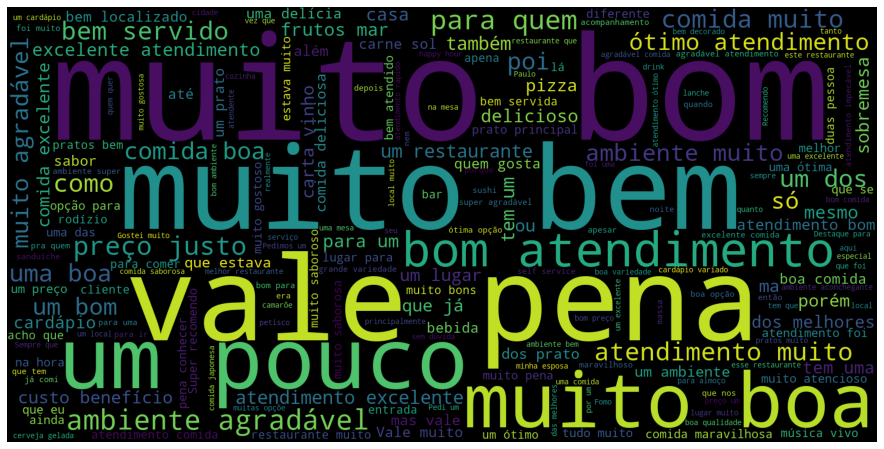

In [33]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
df.dropna(subset=['reviewBody'], axis=0, inplace = True)
summary = df['reviewBody']
all_summary = " ".join(s for s in summary)
stopwords = set(STOPWORDS)
stopwords.update(["da", "meu", "em", "você", "de", "ao", "os", 'não', 'São'])
wordcloud = WordCloud(stopwords=stopwords,background_color='black', width=1600,height=800).generate(all_summary)
fig, ax = plt.subplots(figsize=(16,8))            
ax.imshow(wordcloud, interpolation='bilinear')
ax.set_axis_off()
plt.imshow(wordcloud) 